In [5]:
import numpy as np

import matplotlib.pyplot as plt
import mplhep as hep

plt.style.use(hep.cms.style.ROOT)
plt.rcParams['axes.axisbelow'] = True

In [28]:
models = ['nominal','fgsm-0_01']
modelDir = '/net/scratch_cms3a/hschoenen/deepjet/results/'
saveDir = '/net/scratch_cms3a/hschoenen/deepjet/plots'

def get_array(quantity,model='nominal',attack='nominal'):
    array = np.load('{}/{}/variables/{}/{}.npy'.format(modelDir,model,attack,quantity))
    return array

def softmax(array):
    n_outputs = len(array[:,0])
    N = len(array[0,:])
    softmax_output = np.zeros((n_outputs,N))
    for i in range(N):
        for j in range(n_outputs):
            if np.max(array[:,i])<100:
                softmax_output[j,i] = np.exp(array[j,i])/np.sum(np.exp(array[:,i]))
            else:
                if j==np.argmax(array[:,i]):
                    softmax_output[j,i] = 1
    return softmax_output
    
# save the true flavours (labels)
isB = get_array('isB')
isBB = get_array('isBB')
isLeptonicB = get_array('isLeptonicB')
isC = get_array('isC')
isUDS = get_array('isUDS')
isG = get_array('isG')
# merge flavours
B = isB + isBB + isLeptonicB
C = isC
L = isUDS + isG
flavour_arrays = {
    'isB': isB,
    'isBB': isBB, 
    'isLeptonicB': isLeptonicB, 
    'isC': isC, 
    'isUDS': isUDS,
    'isG': isG,
    'B': B,
    'C': C,
    'L': L,
}

# save the model outputs
output_names = ['prob_isB', 'prob_isBB', 'prob_isLeptonicB', 'prob_isC', 'prob_isUDS', 'prob_isG']
model_outputs = {
    'nominal': 0,
    'fgsm-0_01': 0
}
for model in models:
    output = [get_array(output_name, model=model) for output_name in output_names]
    output = np.array(output)
    output = softmax(output)
    output_dictionary = {
        'prob_isB': output[0,:],
        'prob_isBB': output[1,:],
        'prob_isLeptonicB': output[2,:],
        'prob_isC': output[3,:],
        'prob_isUDS': output[4,:],
        'prob_isG': output[5,:],
        'prob_B': output[0,:]+output[1,:]+output[2,:],
        'prob_C': output[3,:],
        'prob_L': output[4,:]+output[5,:],
        'BvsL': (output[0,:]+output[1,:]+output[2,:]) / (output[0,:]+output[1,:]+output[2,:]+output[4,:]+output[5,:]),
        'CvsB': (output[3,:]) / (output[0,:]+output[1,:]+output[2,:]+output[3,:]),
        'CvsL': (output[3,:]) / (output[3,:]+output[4,:]+output[5,:])
    }
    model_outputs[model] = output_dictionary

In [29]:
quantity_labels = {
    'prob_isB': 'P(b)',
    'prob_isBB': 'P(bb)', 
    'prob_isLeptonicB': 'P(lepb)', 
    'prob_isC': 'P(c)', 
    'prob_isUDS': 'P(uds)',
    'prob_isG': 'P(g)',
    'BvsL': 'BvsL',
    'CvsB': 'CvsB',
    'CvsL': 'CvsL',
}
quantity_colors = {
    'prob_isB': 'blue',
    'prob_isBB': 'darkblue', 
    'prob_isLeptonicB': 'skyblue', 
    'prob_isC': 'green', 
    'prob_isUDS': 'red',
    'prob_isG': 'darkred',
}
flavour_labels = {
    'isB': 'b jets',
    'isBB': 'bb jets', 
    'isLeptonicB': 'lep b jets', 
    'isC': 'c jets', 
    'isUDS': 'uds jets',
    'isG': 'g jets',
    'B': '(b,bb,lepb) jets',
    'C': 'c jets',
    'L': '(uds,g) jets'
}
flavour_colors = {
    'isB': 'blue',
    'isBB': 'darkblue', 
    'isLeptonicB': 'skyblue', 
    'isC': 'green', 
    'isUDS': 'red',
    'isG': 'darkred',
    'B': 'blue',
    'C': 'green',
    'L': 'red'
}
model_labels = {
    'nominal': 'DeepJet, nominal training',
    'fgsm-0_01': r'DeepJet, fgsm training $\epsilon=0.01$'
}

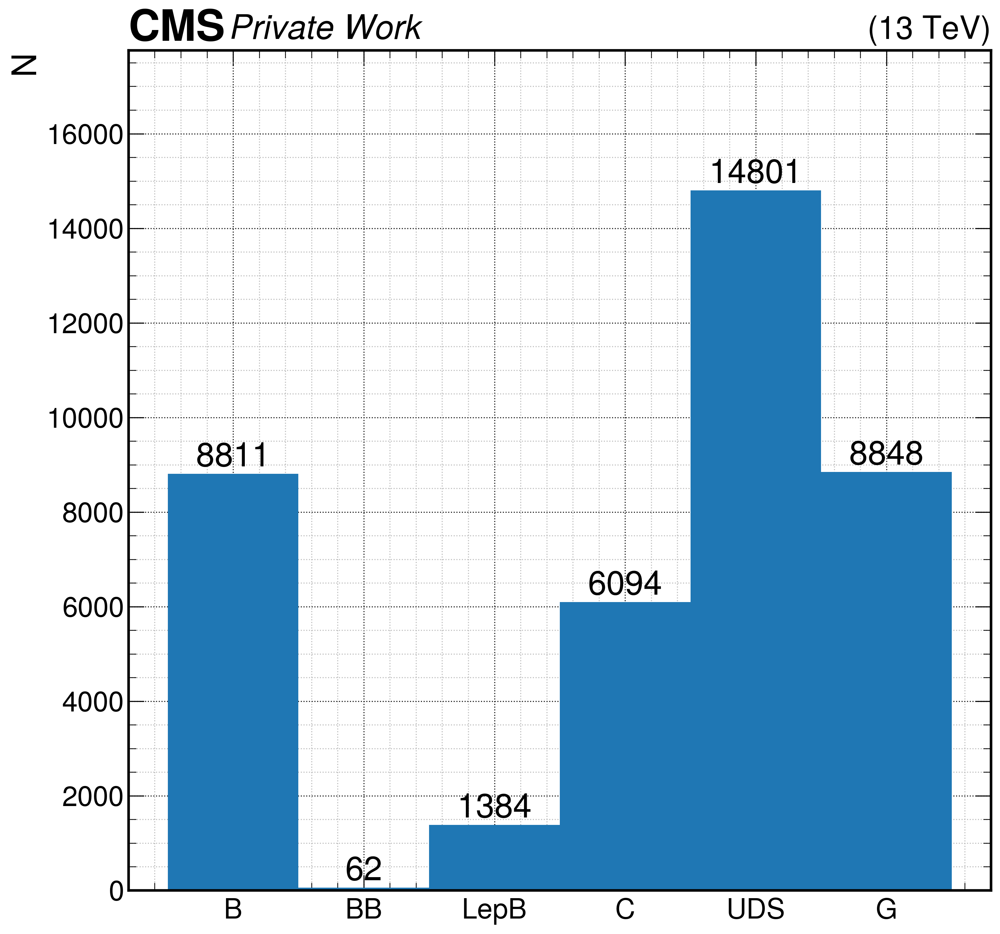

In [30]:
### Histogram with true jet flavours (labels)
flavour_counts = [np.sum(isB), np.sum(isBB), np.sum(isLeptonicB), np.sum(isC), np.sum(isUDS), np.sum(isG)] 
flavour_ids = [1,2,3,4,5,6]
bins = [0.5,1.5,2.5,3.5,4.5,5.5,6.5]
fig,ax = plt.subplots(figsize=[12,12], dpi=300)
ax.set_ylim(top=1.2*np.max(flavour_counts))
ax.set_ylabel('N')
ax.grid(which='minor', alpha=0.85)
ax.grid(which='major', alpha=0.95, color='black')
counts, edges, bars = ax.hist(flavour_ids, weights=flavour_counts, bins=bins, histtype='barstacked')
plt.bar_label(bars)
ax.set_xticks(ticks=[1,2,3,4,5,6], labels=['B','BB','LepB','C','UDS','G'])
hep.cms.label(llabel='Private Work', rlabel='(13 TeV)')
fig.savefig('{}/outputs/labels.pdf'.format(saveDir))

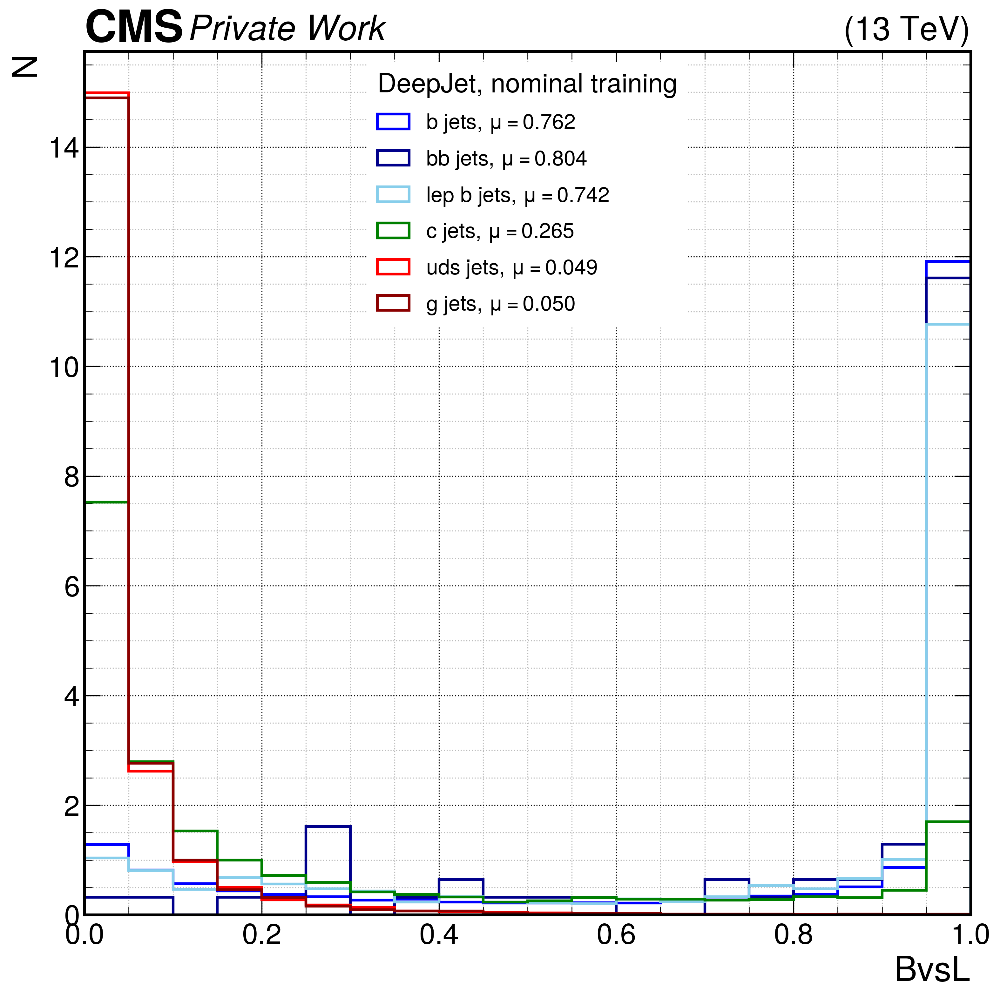

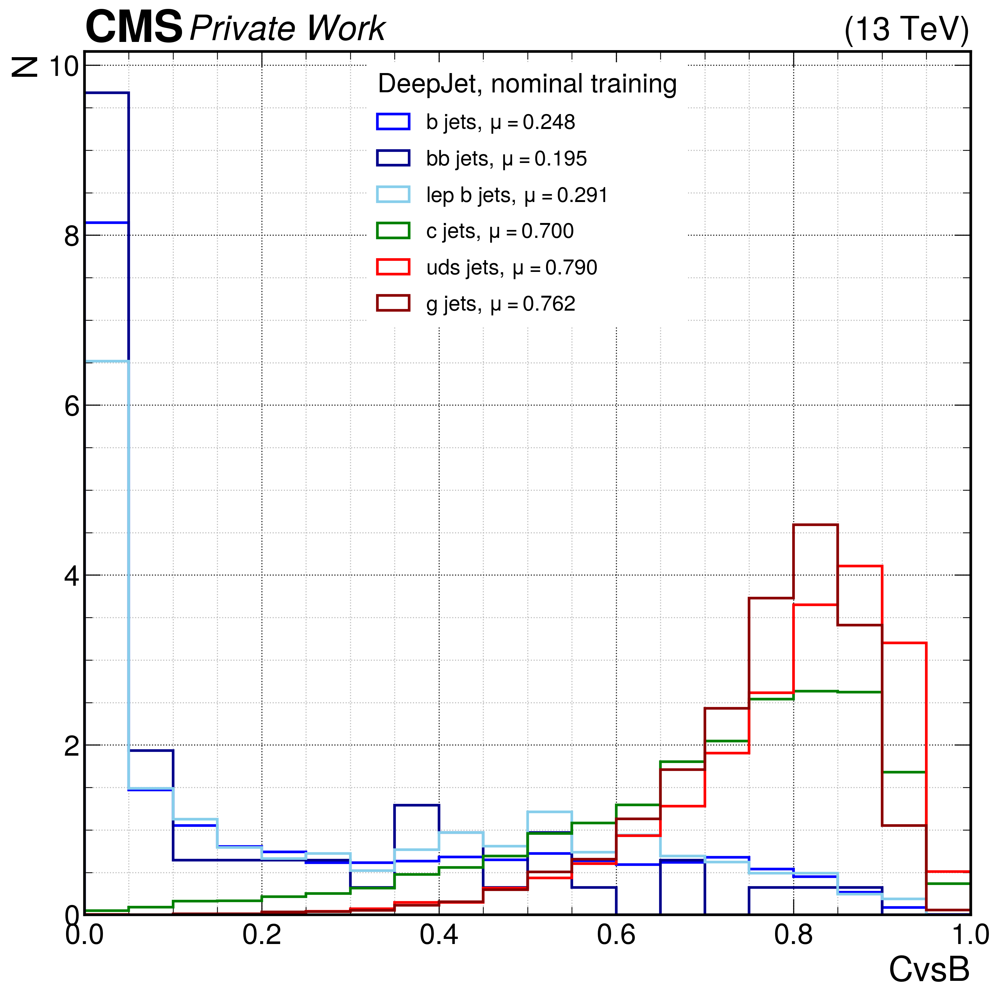

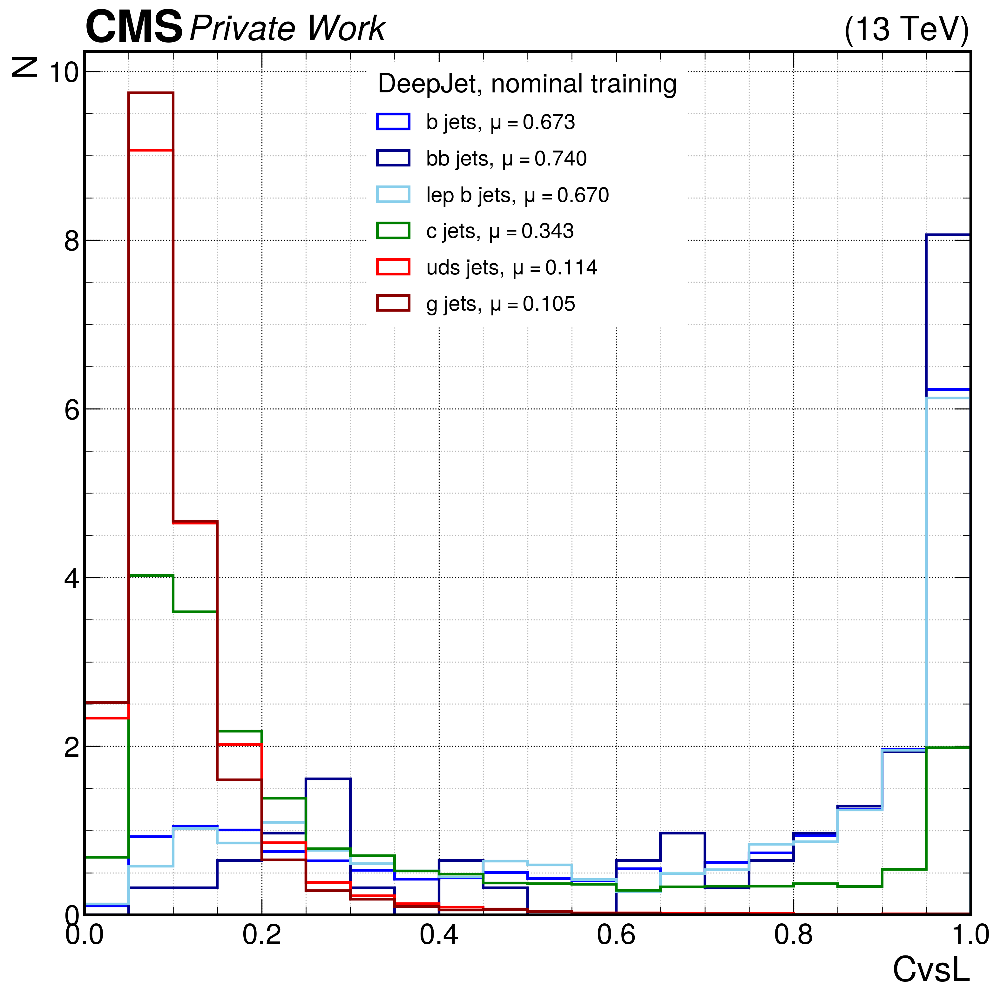

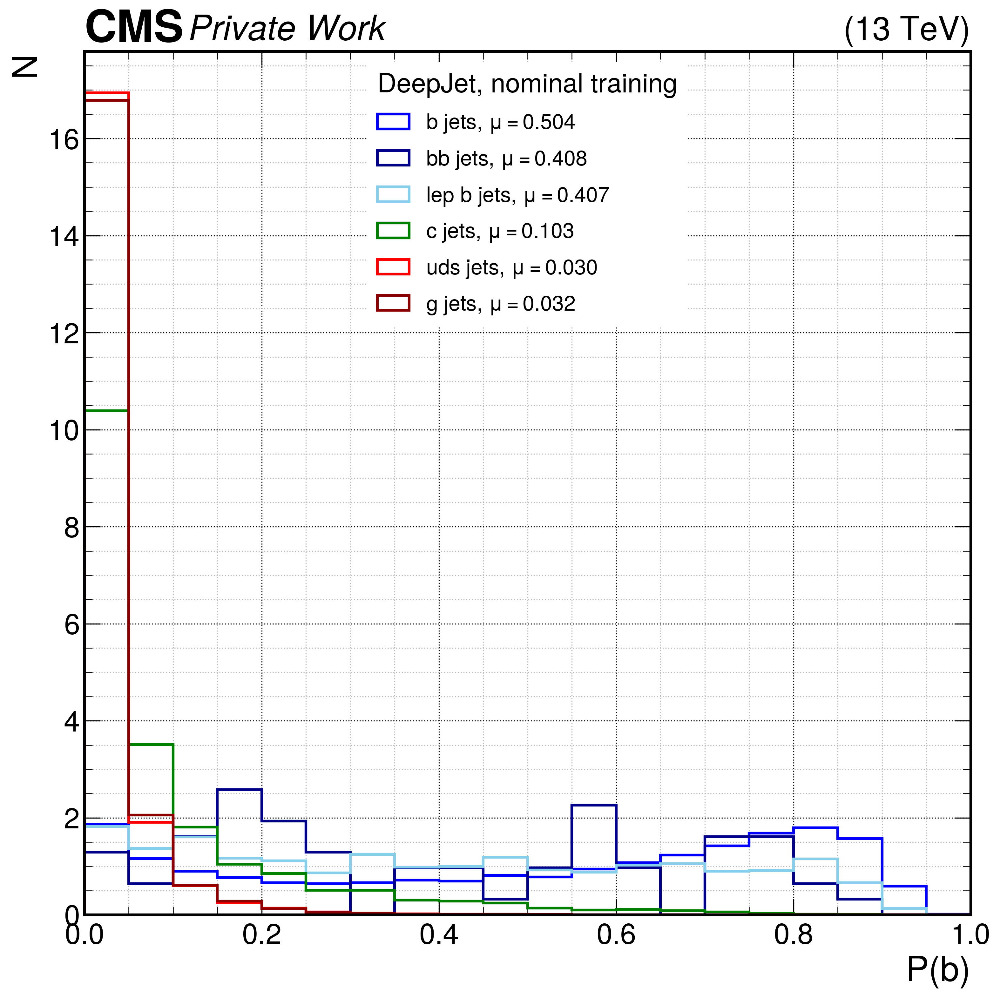

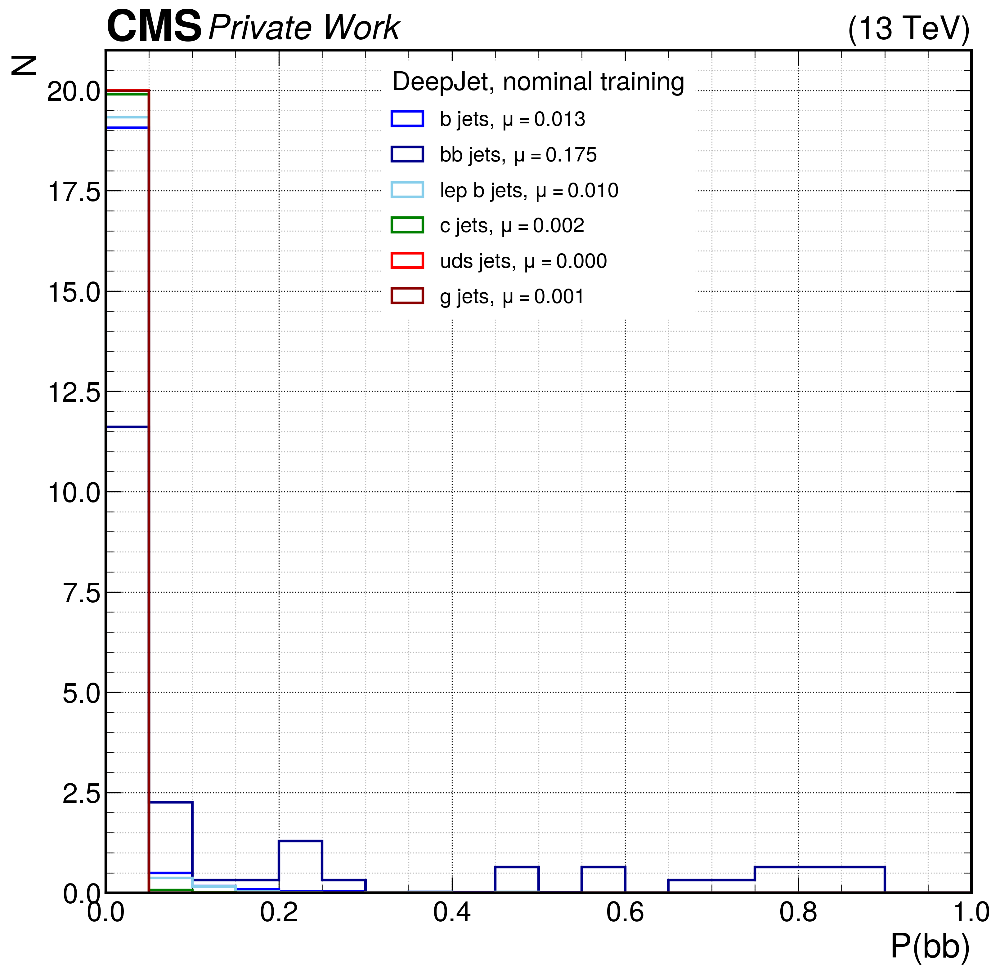

...

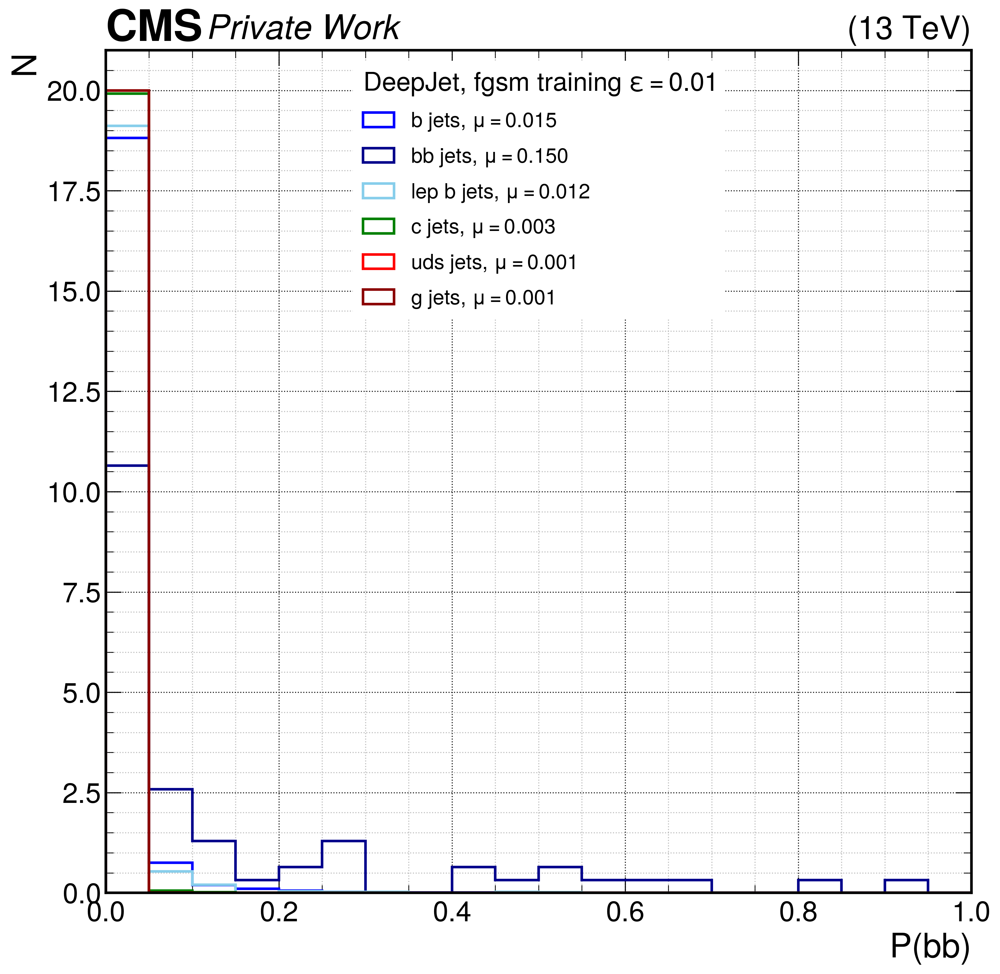

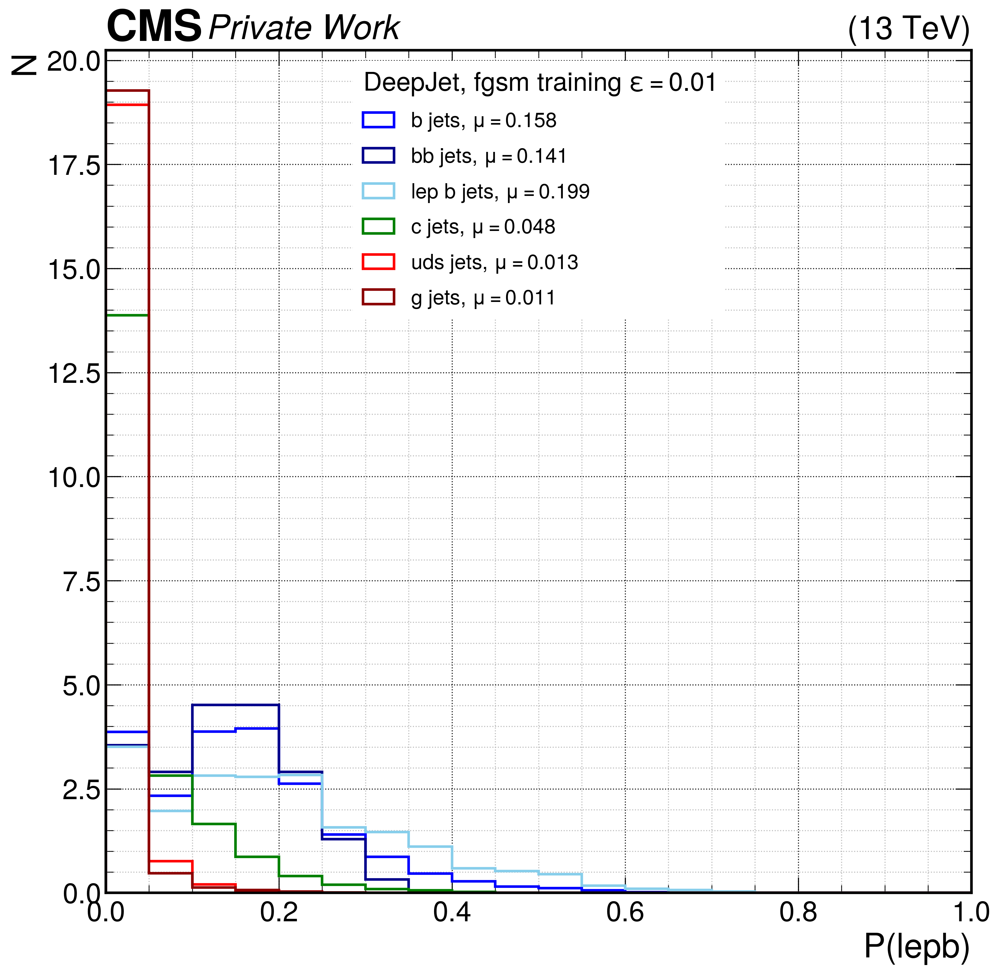

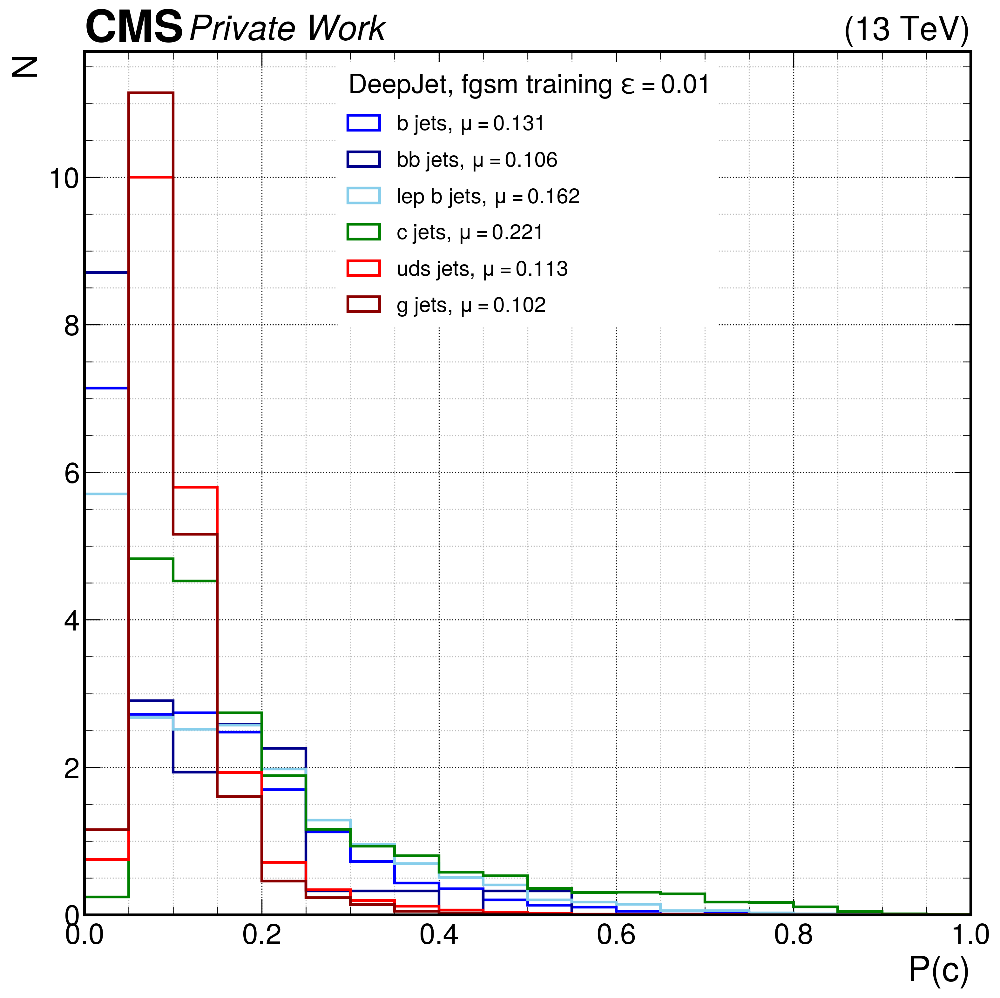

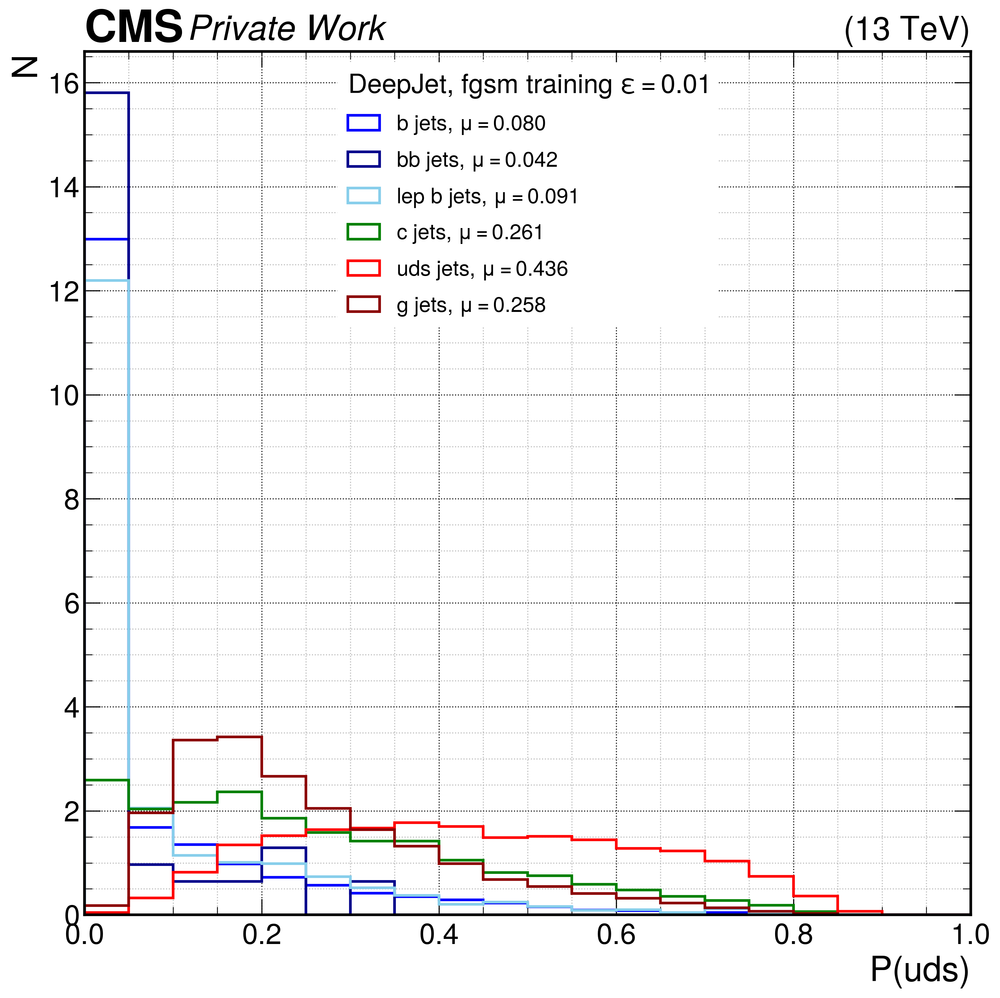

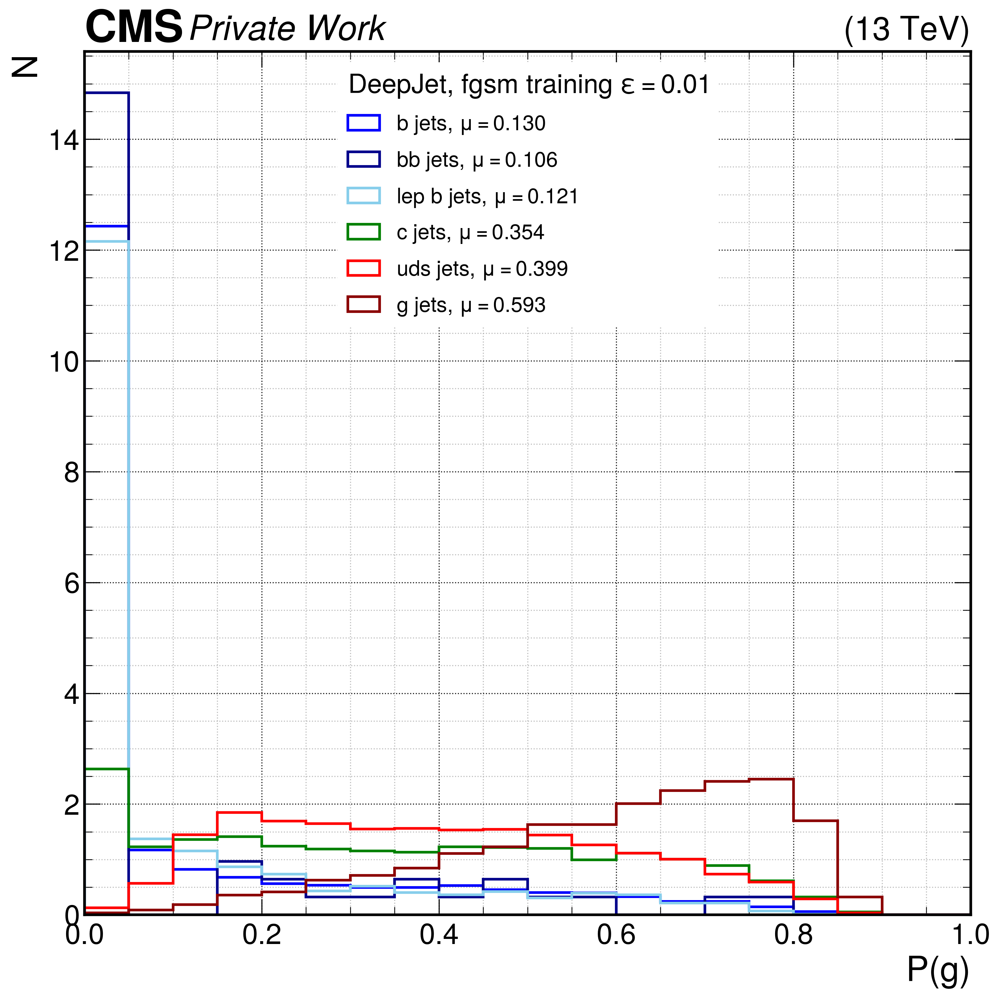

In [32]:
### Plot output and discriminator distributions
models = ['nominal','fgsm-0_01']
quantities = ['BvsL', 'CvsB', 'CvsL', 'prob_isB', 'prob_isBB', 'prob_isLeptonicB', 'prob_isC', 'prob_isUDS', 'prob_isG']
# specify: merge flavours? (B=b+bb+lepb, L=uds+g)
merge_flavours = False
if merge_flavours:
    flavours = ['B', 'C', 'L']
else:
    flavours = ['isB', 'isBB', 'isLeptonicB', 'isC', 'isUDS', 'isG']
# specify: normalize histograms by flavour?
normalize_by_flavour = True
# adjust binning: [left edge, right edge, number of bins]
binning = [0,1,20]

for model in models:
    for quantity in quantities:
        # get quantity array
        quantity_array = model_outputs[model][quantity]
        # create figure
        fig,ax = plt.subplots(figsize=[12,12], dpi=300)
        ax.set_xlim(left=0, right=1)
        ax.set_ylabel('N')
        ax.set_xlabel(quantity_labels[quantity])
        ax.grid(which='minor', alpha=0.85)
        ax.grid(which='major', alpha=0.95, color='black')
        # plot histograms
        if normalize_by_flavour:
            for flavour in flavours:
                flavour_array = flavour_arrays[flavour]
                array = quantity_array[flavour_array==1]
                label = '{}, $\mu =${:.3f}'.format(flavour_labels[flavour],np.mean(array))
                color = flavour_colors[flavour]
                ax.hist(array, label=label, color=color, density=normalize_by_flavour, bins=binning[2], range=(binning[0],binning[1]), linewidth=2, histtype='step')
        legloc = 'upper center'
        leg=ax.legend(title=model_labels[model], fontsize=16, title_fontsize=20, labelspacing=0.7, loc=legloc, frameon=True, framealpha=1, facecolor='white')
        if 'right' in legloc:
            aligned = 'right'
        else:
            aligned = 'left'
        leg._legend_box.align = aligned
        leg.get_frame().set_linewidth(0.0)
        hep.cms.label(llabel='Private Work', rlabel='(13 TeV)')
        fig.savefig('{}/outputs/{}-{}.pdf'.format(saveDir,model,quantity))

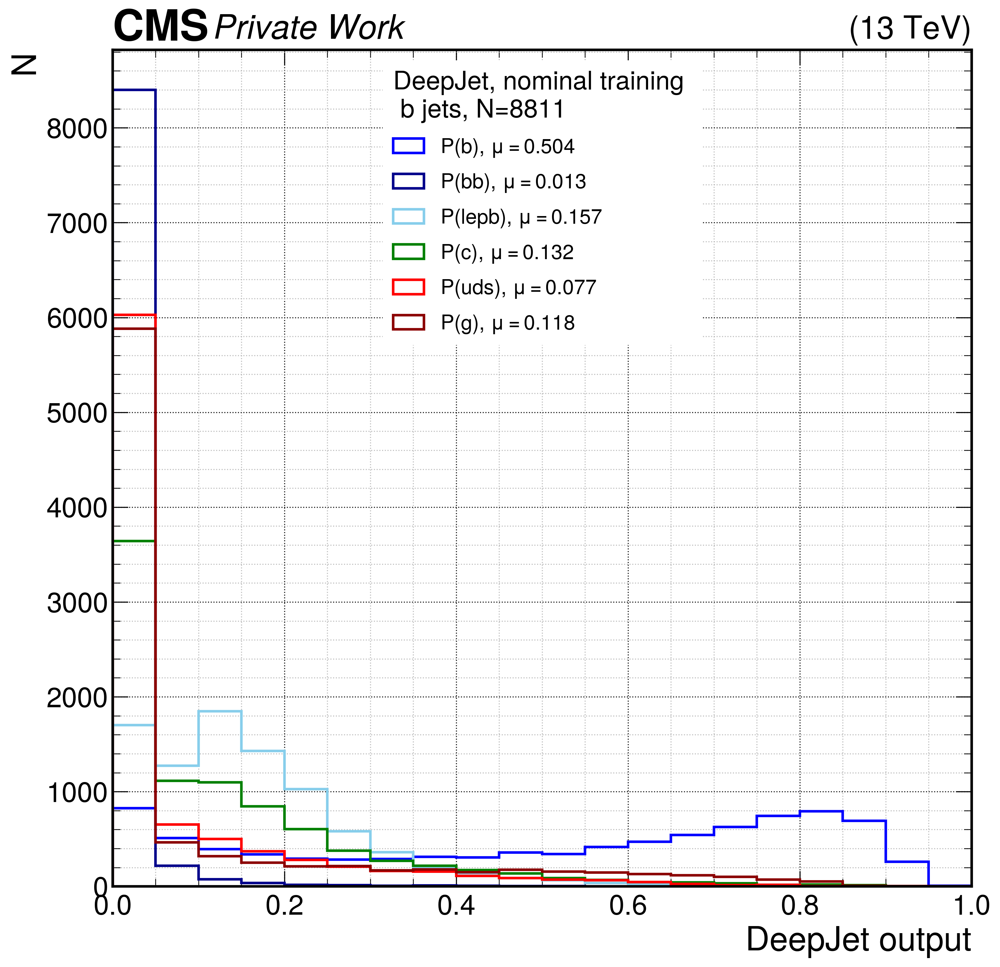

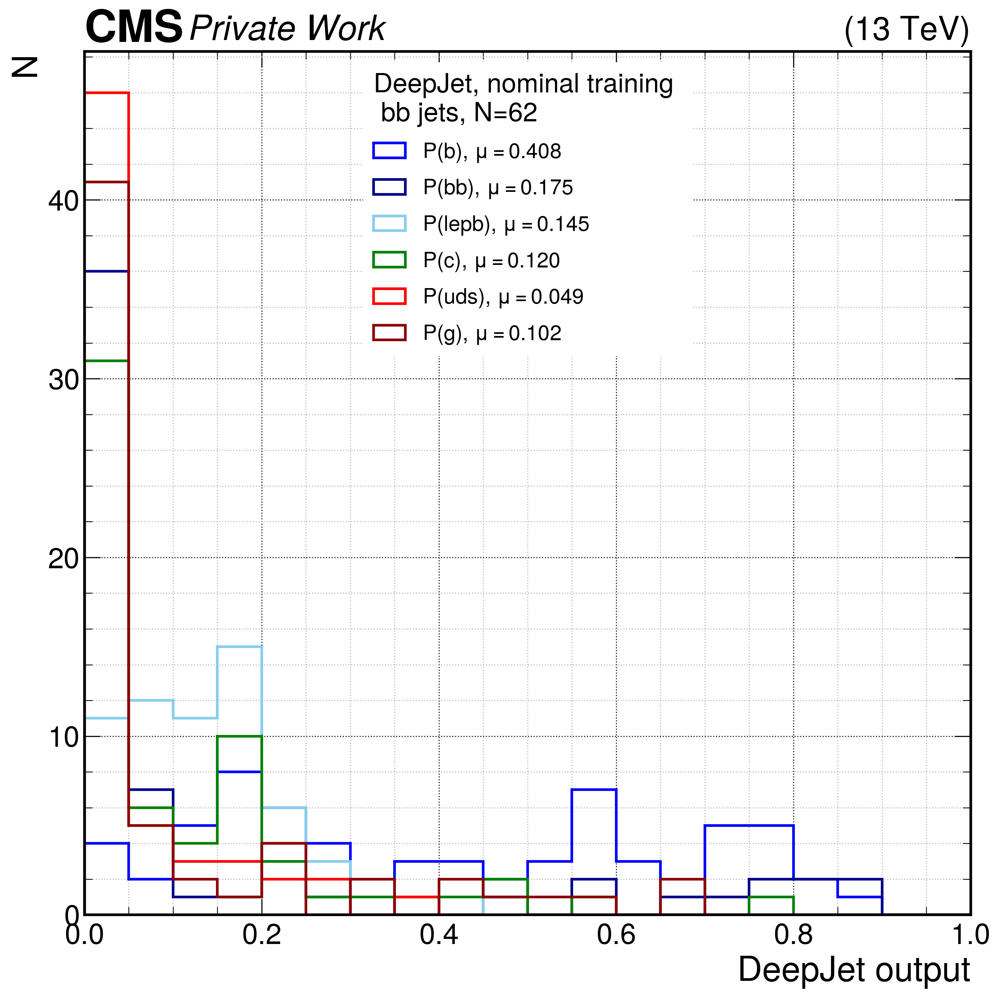

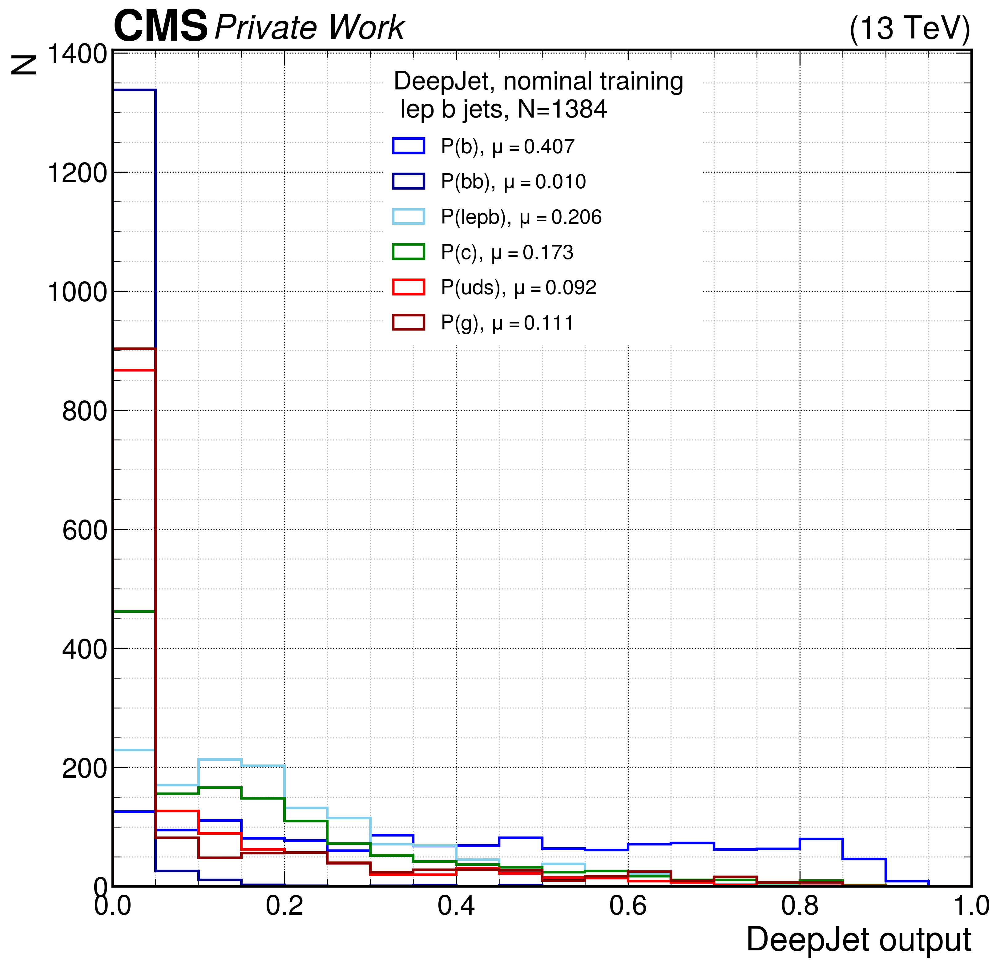

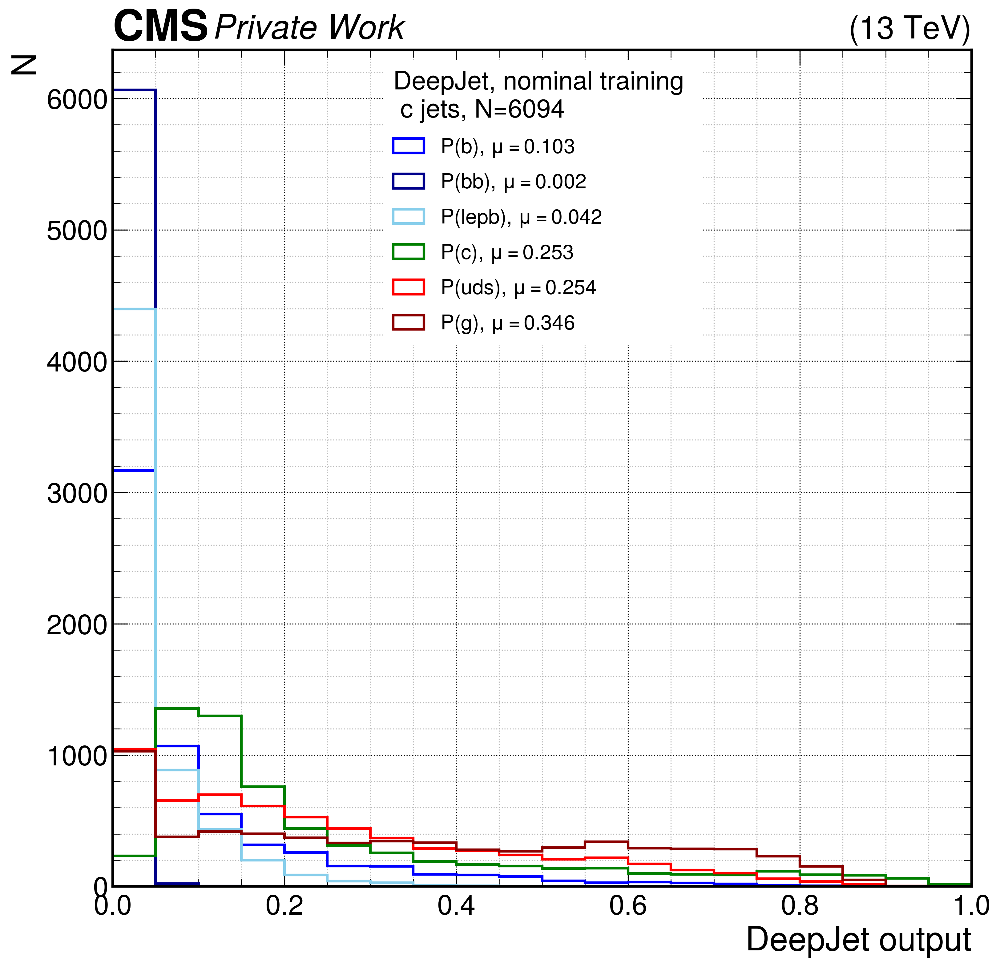

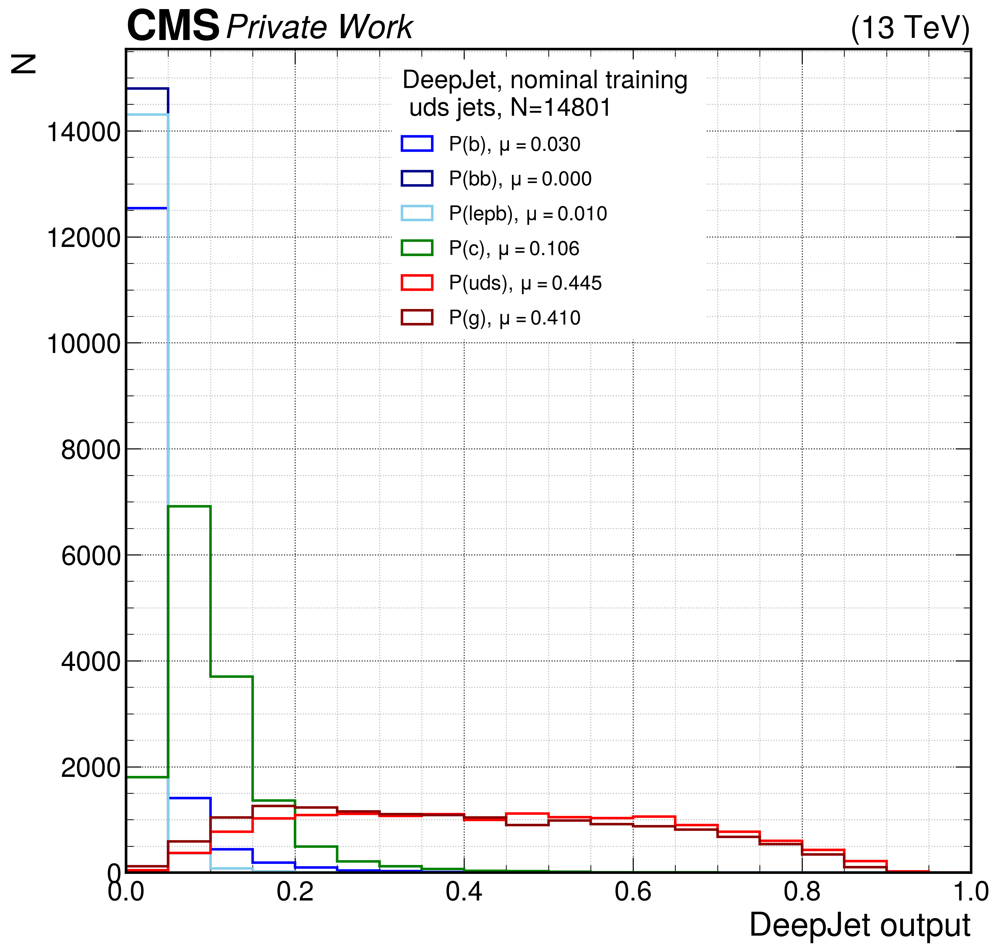

...

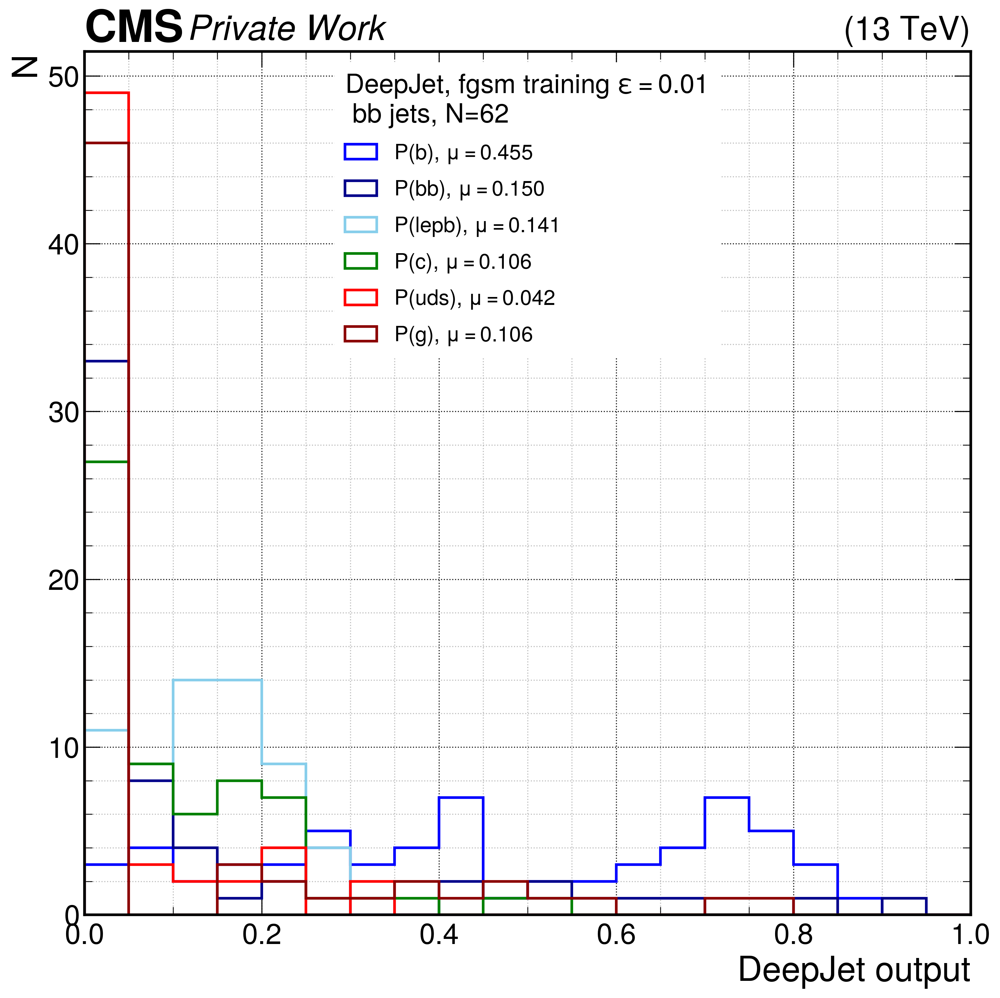

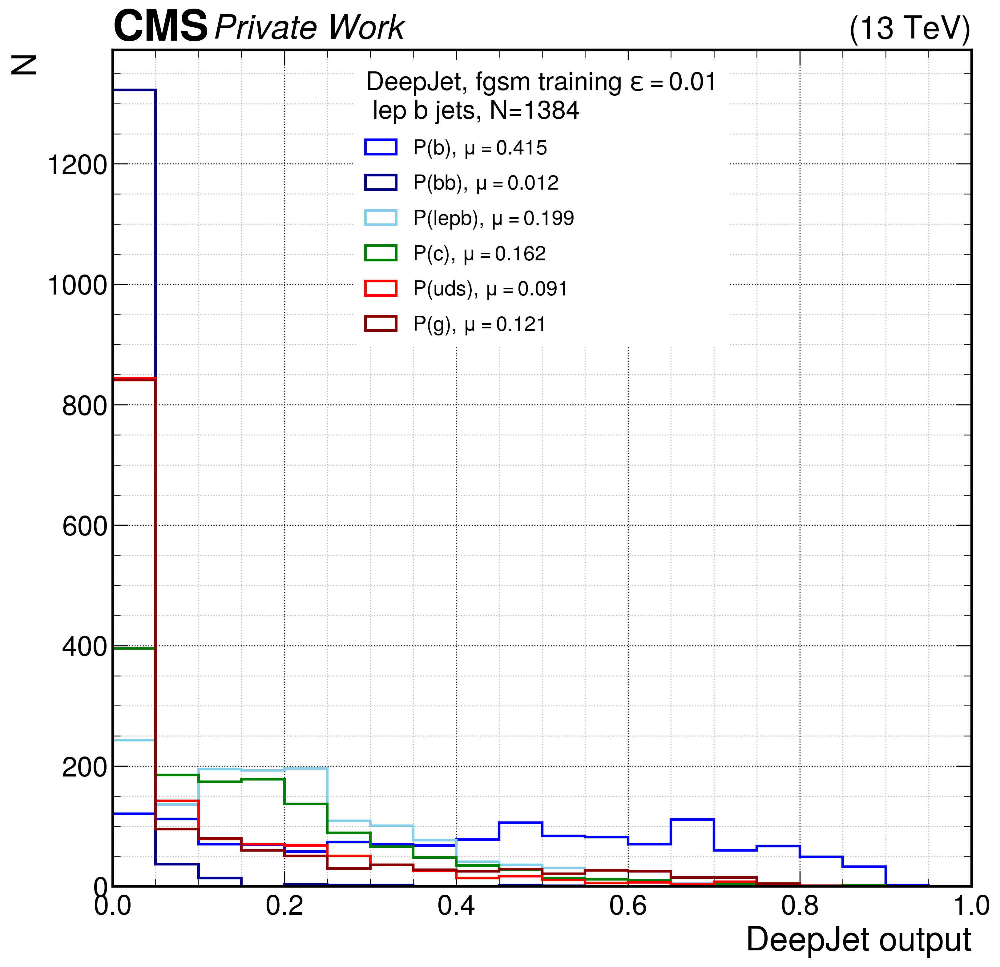

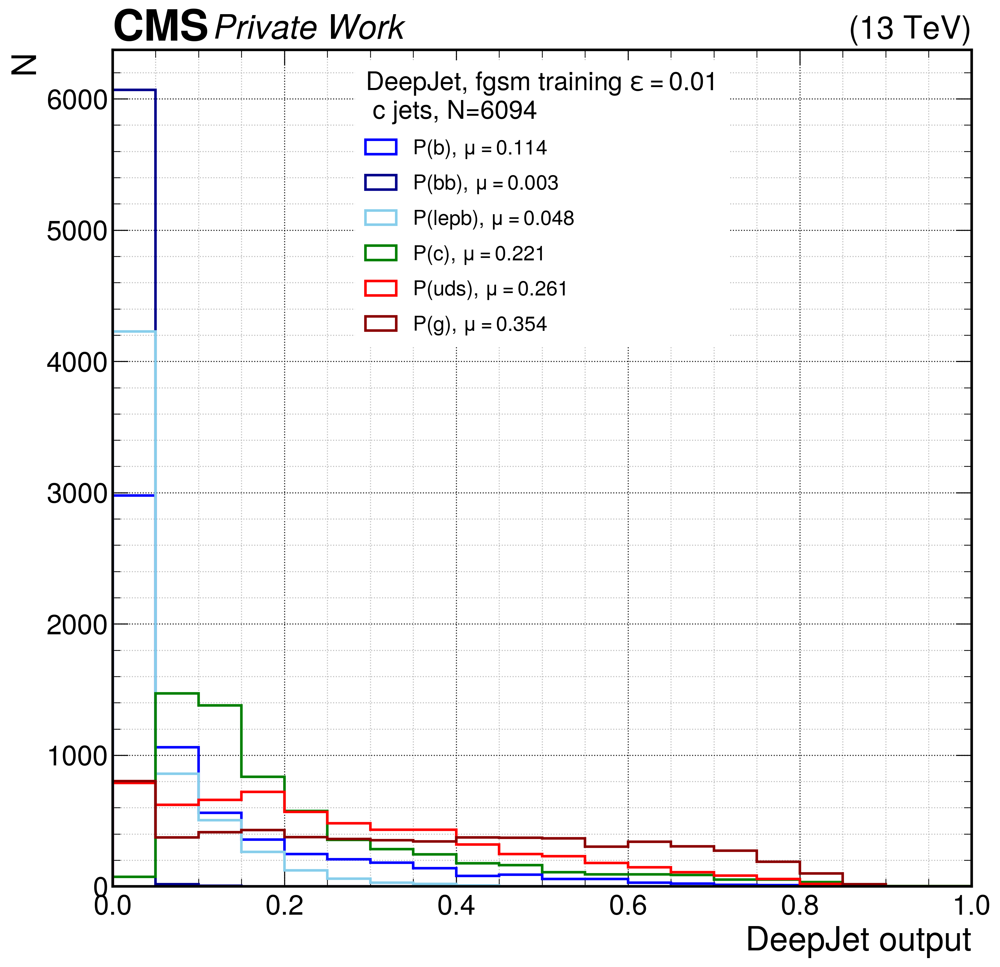

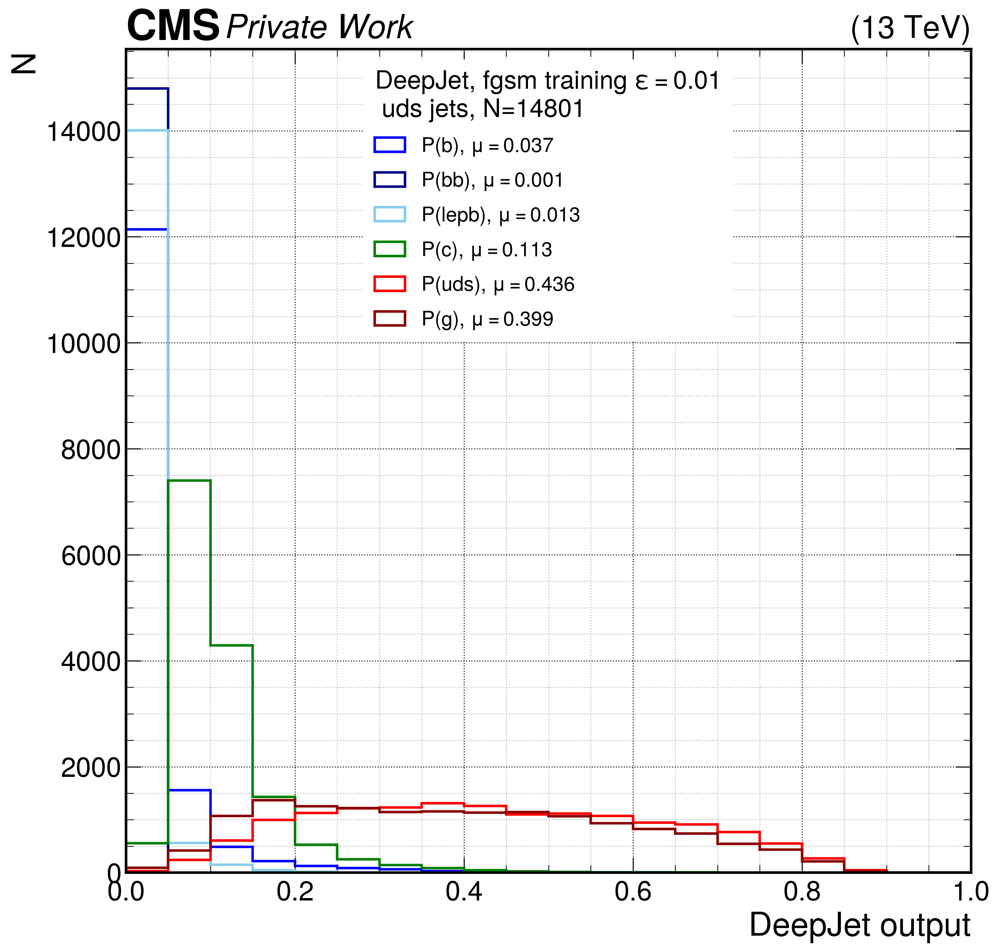

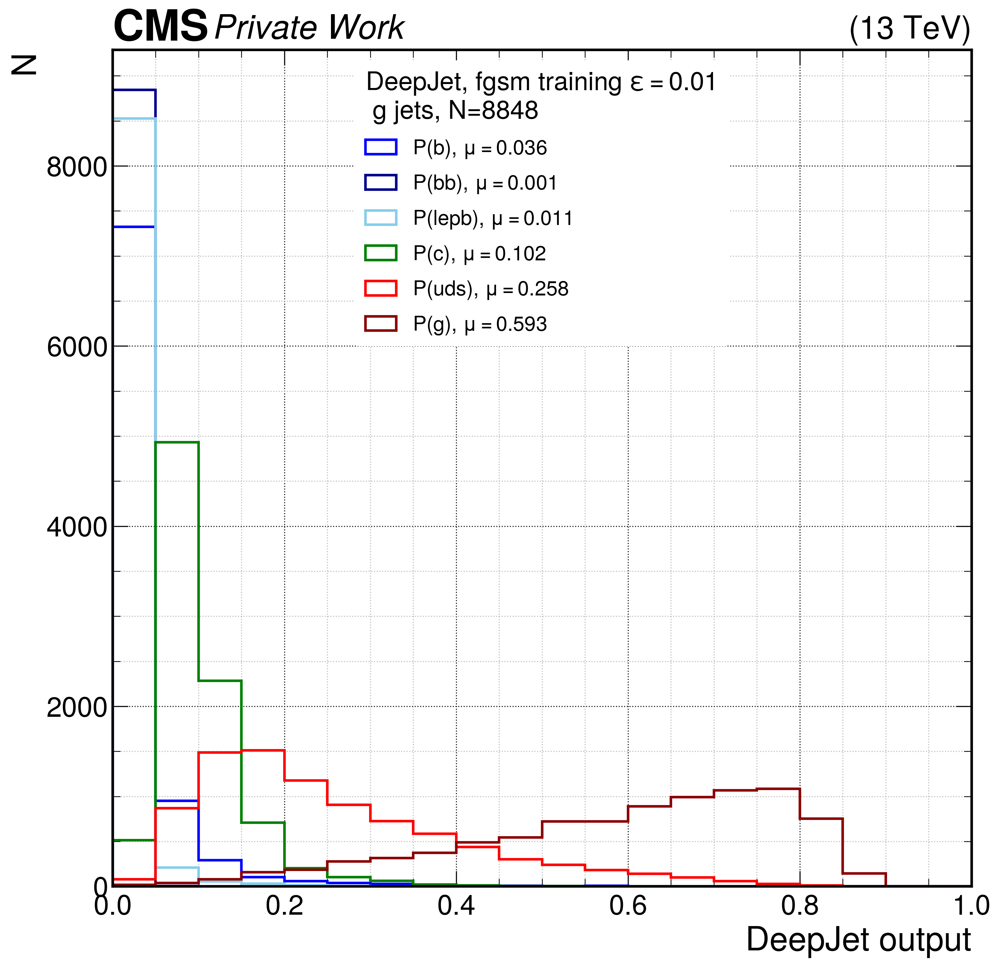

In [34]:
### Plot outputs for each flavour
models = ['nominal','fgsm-0_01']
flavours = ['isB', 'isBB', 'isLeptonicB', 'isC', 'isUDS', 'isG']
quantities = ['prob_isB', 'prob_isBB', 'prob_isLeptonicB', 'prob_isC', 'prob_isUDS', 'prob_isG']
# adjust binning: [left edge, right edge, number of bins]
binning = [0,1,20]

for model in models:
    for flavour in flavours:
        # get true flavour
        flavour_array = flavour_arrays[flavour]
        # create figure
        fig,ax = plt.subplots(figsize=[12,12], dpi=300)
        ax.set_xlim(left=0, right=1)
        ax.set_ylabel('N')
        ax.set_xlabel('DeepJet output')
        ax.grid(which='minor', alpha=0.85)
        ax.grid(which='major', alpha=0.95, color='black')
        # plot histograms
        for quantity in quantities:
            quantity_array = model_outputs[model][quantity]
            array = quantity_array[flavour_array==1]
            label = '{}, $\mu =${:.3f}'.format(quantity_labels[quantity],np.mean(array))
            color = quantity_colors[quantity]
            ax.hist(array, bins=binning[2], range=(binning[0],binning[1]), label=label, color=color, linewidth=2, histtype='step')
        legloc = 'upper center'
        legtitle = '{} \n {}, N={:n}'.format(model_labels[model],flavour_labels[flavour],np.sum(flavour_array))
        leg=ax.legend(title=legtitle, fontsize=16, title_fontsize=20, labelspacing=0.7, loc=legloc, frameon=True, framealpha=1, facecolor='white')
        if 'right' in legloc:
            aligned = 'right'
        else:
            aligned = 'left'
        leg._legend_box.align = aligned
        leg.get_frame().set_linewidth(0.0)
        hep.cms.label(llabel='Private Work', rlabel='(13 TeV)')
        fig.savefig('{}/outputs/{}-{}_outputs.pdf'.format(saveDir,model,flavour))

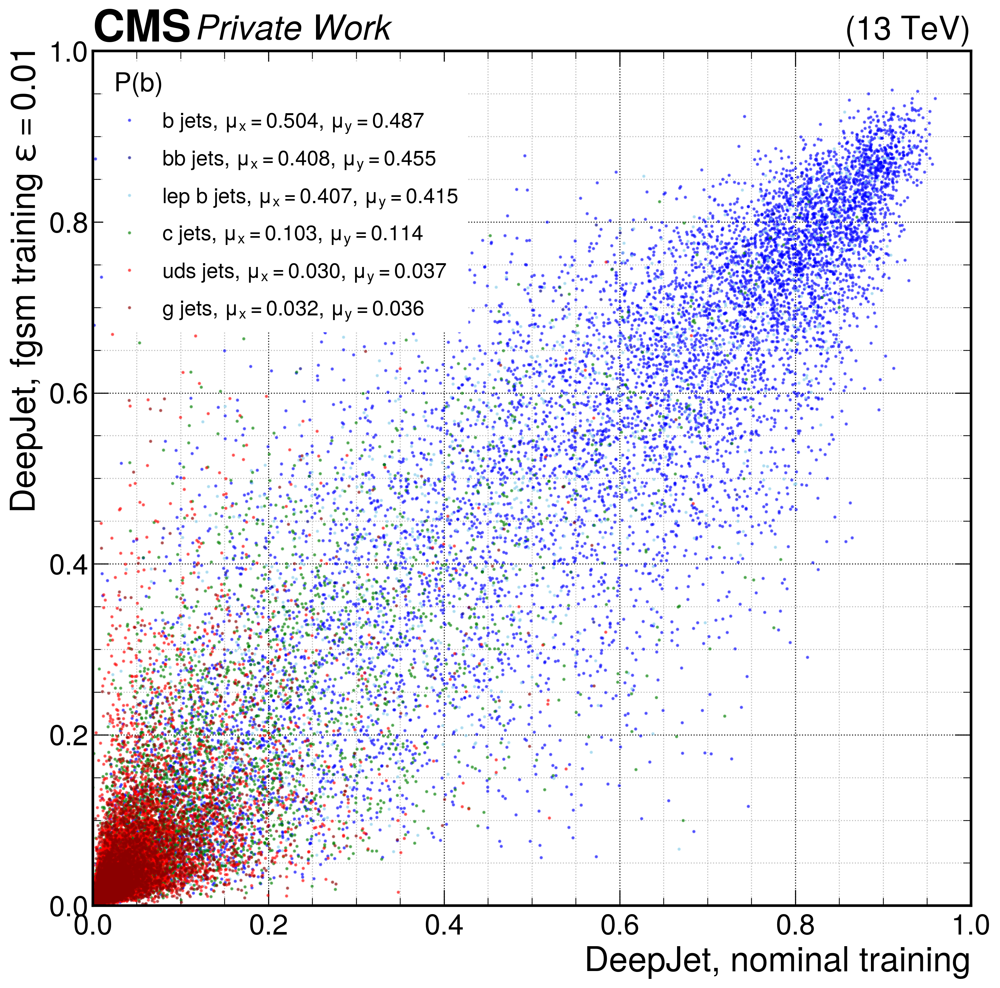

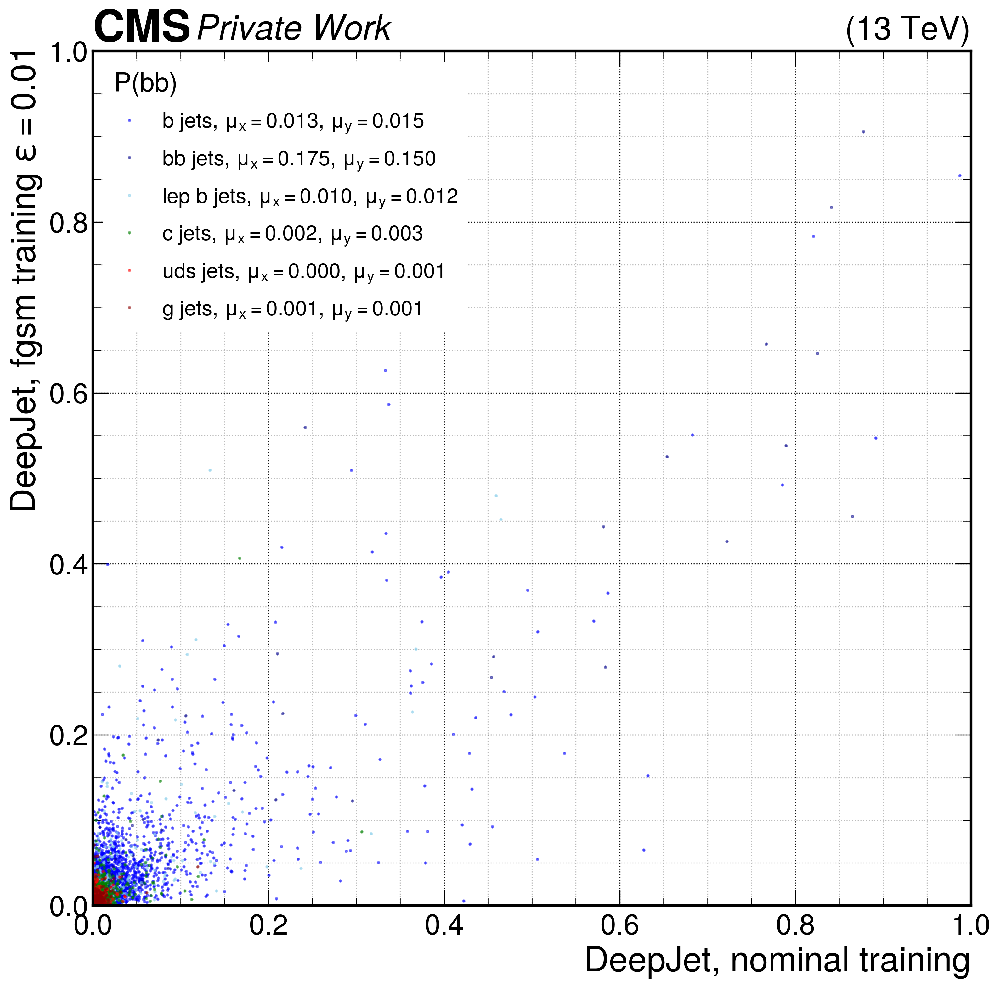

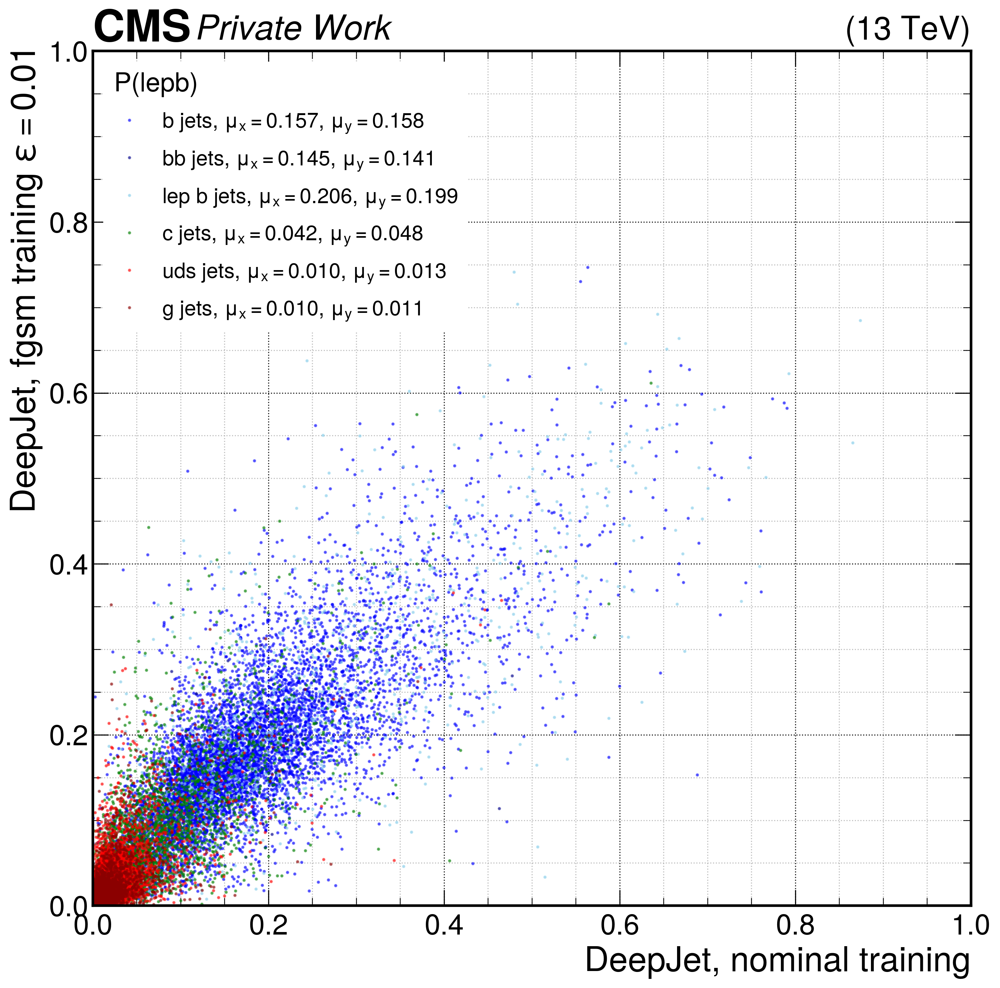

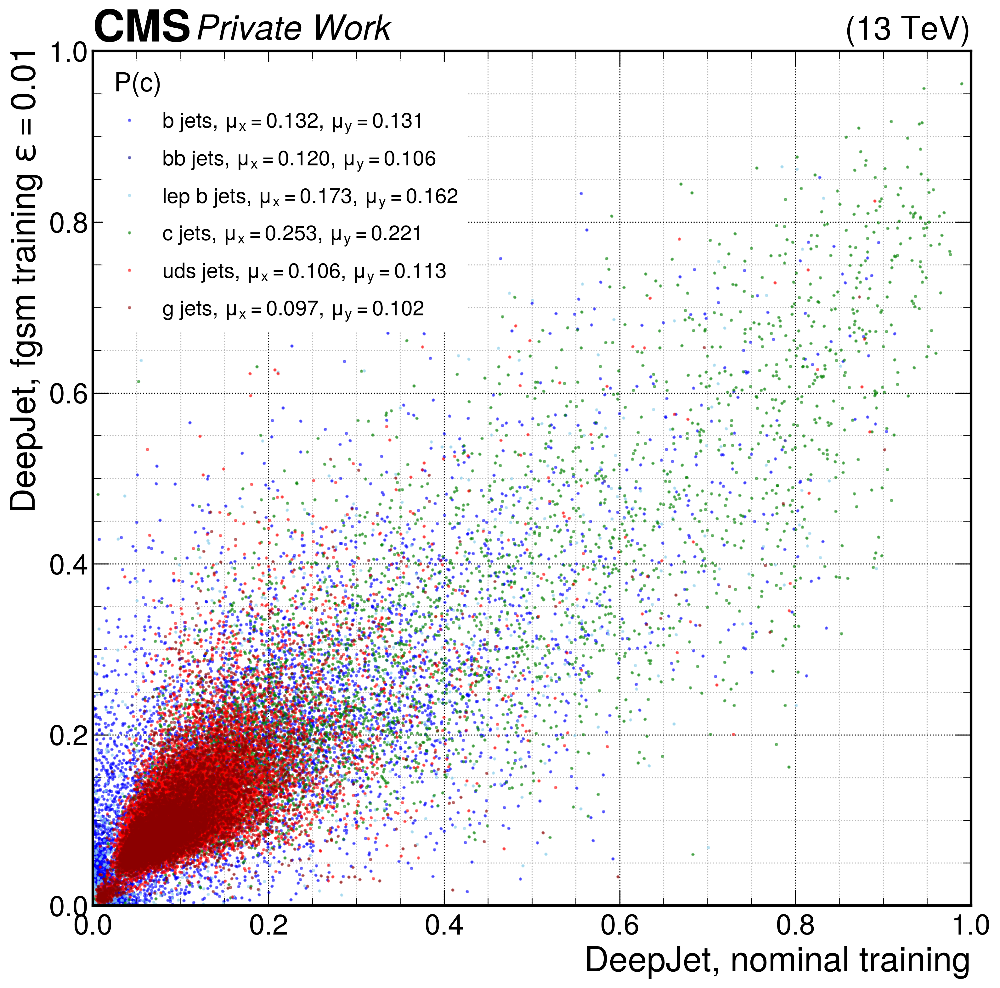

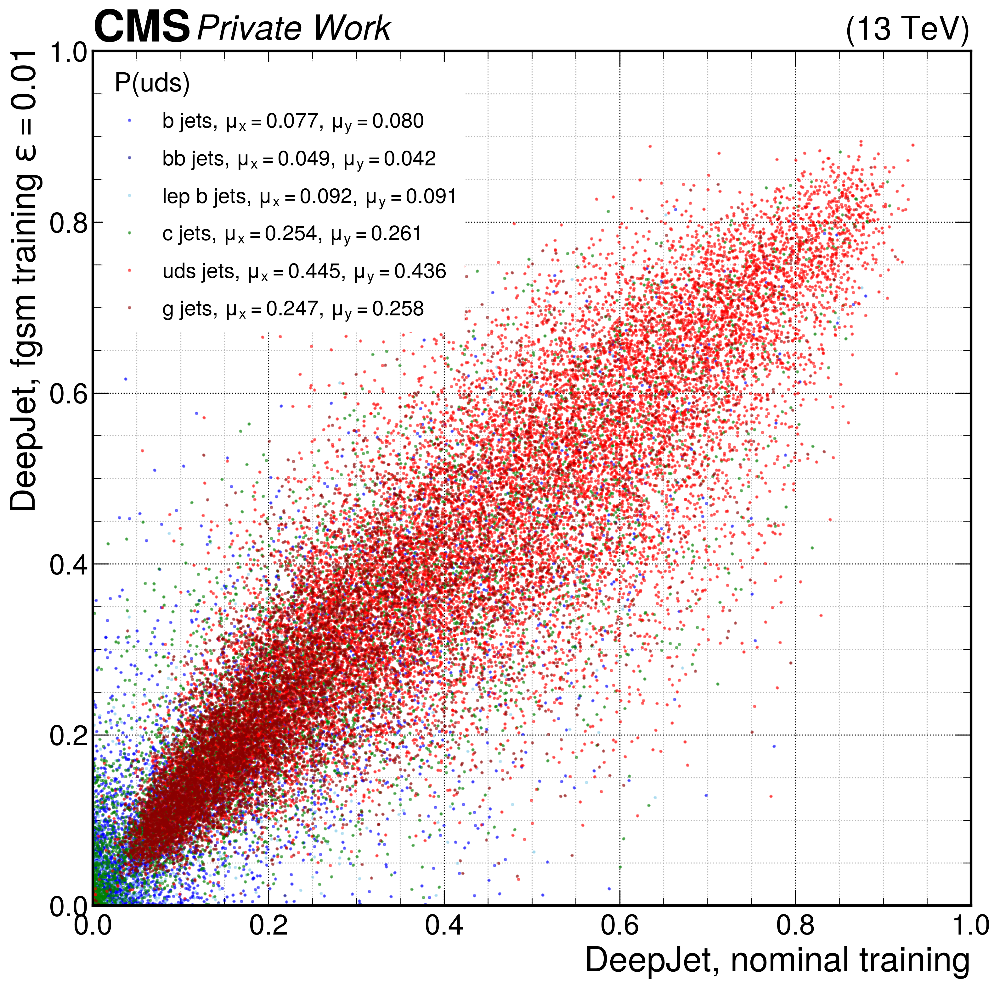

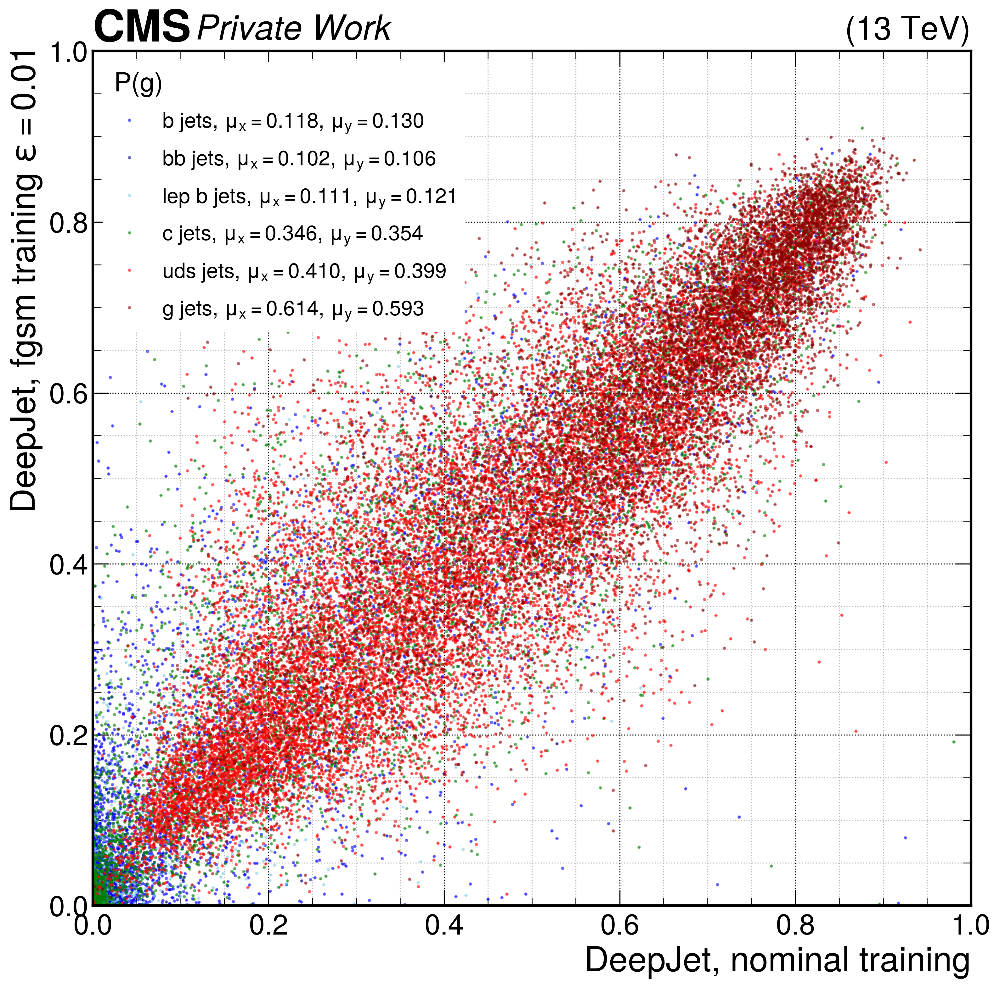

In [37]:
### plot correlation: outputs of different models (2D histogram)
models = ['nominal','fgsm-0_01']
quantities = ['prob_isB', 'prob_isBB', 'prob_isLeptonicB', 'prob_isC', 'prob_isUDS', 'prob_isG']
flavours = ['isB', 'isBB', 'isLeptonicB', 'isC', 'isUDS', 'isG']

for quantity in quantities:
    quantity_array1 = model_outputs[models[0]][quantity]
    quantity_array2 = model_outputs[models[1]][quantity]
    fig,ax = plt.subplots(figsize=[12,12], dpi=300)
    ax.set_ylim(bottom=0, top=1)
    ax.set_xlim(left=0, right=1)
    ax.set_ylabel(model_labels[models[1]])
    ax.set_xlabel(model_labels[models[0]])
    ax.grid(which='minor', alpha=0.85)
    ax.grid(which='major', alpha=0.95, color='black')
    # plot histograms
    for flavour in flavours:
        flavour_array = flavour_arrays[flavour]
        x_array = quantity_array1[flavour_array==1]
        y_array = quantity_array2[flavour_array==1]
        label = '{}, $\mu_x =${:.3f}, $\mu_y =${:.3f}'.format(flavour_labels[flavour],np.mean(x_array),np.mean(y_array))
        color = flavour_colors[flavour]
        ax.plot(x_array, y_array, label=label, color=color, linestyle='None', marker='.', markersize=3, alpha=0.5)
    legloc = 'upper left'
    leg=ax.legend(title=quantity_labels[quantity], fontsize=16, title_fontsize=20, labelspacing=0.7, loc=legloc, frameon=True, framealpha=1, facecolor='white')
    if 'right' in legloc:
        aligned = 'right'
    else:
        aligned = 'left'
    leg._legend_box.align = aligned
    leg.get_frame().set_linewidth(0.0)
    hep.cms.label(llabel='Private Work', rlabel='(13 TeV)')
    fig.savefig('{}/outputs/correlation-{}.pdf'.format(saveDir,quantity))

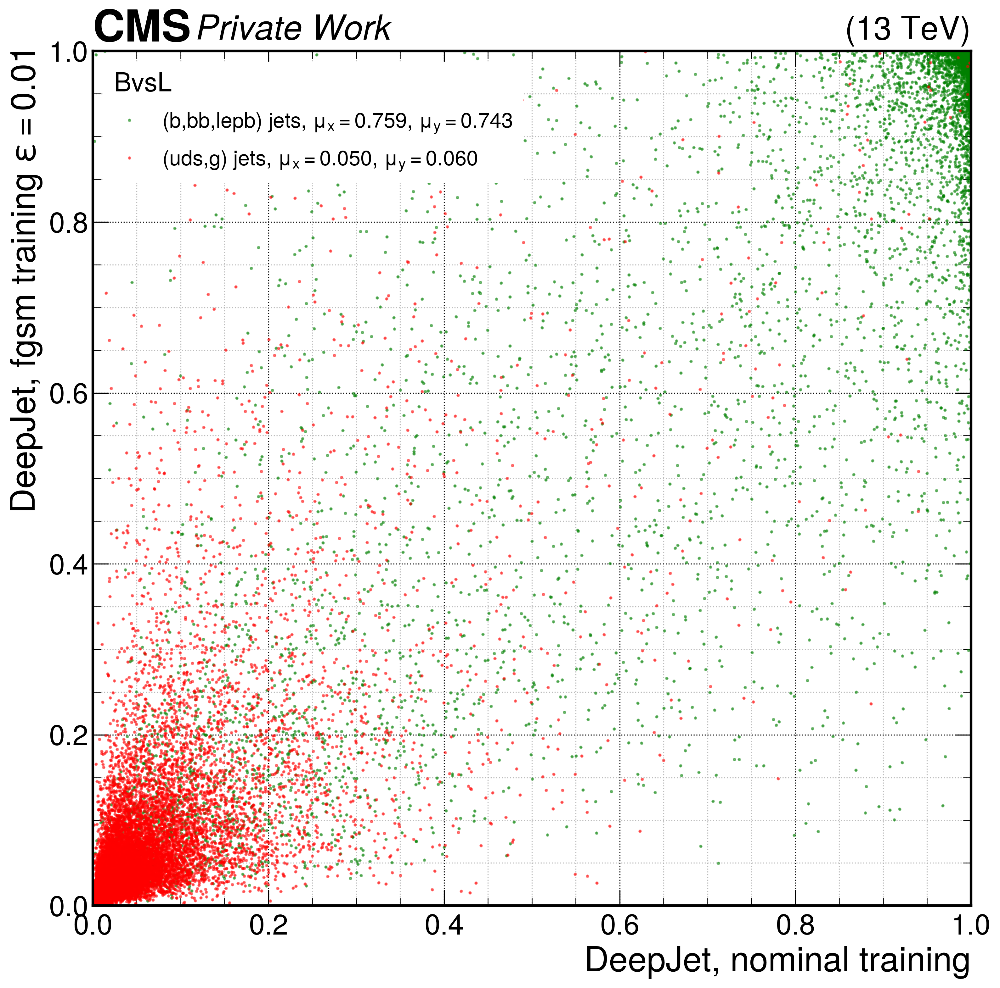

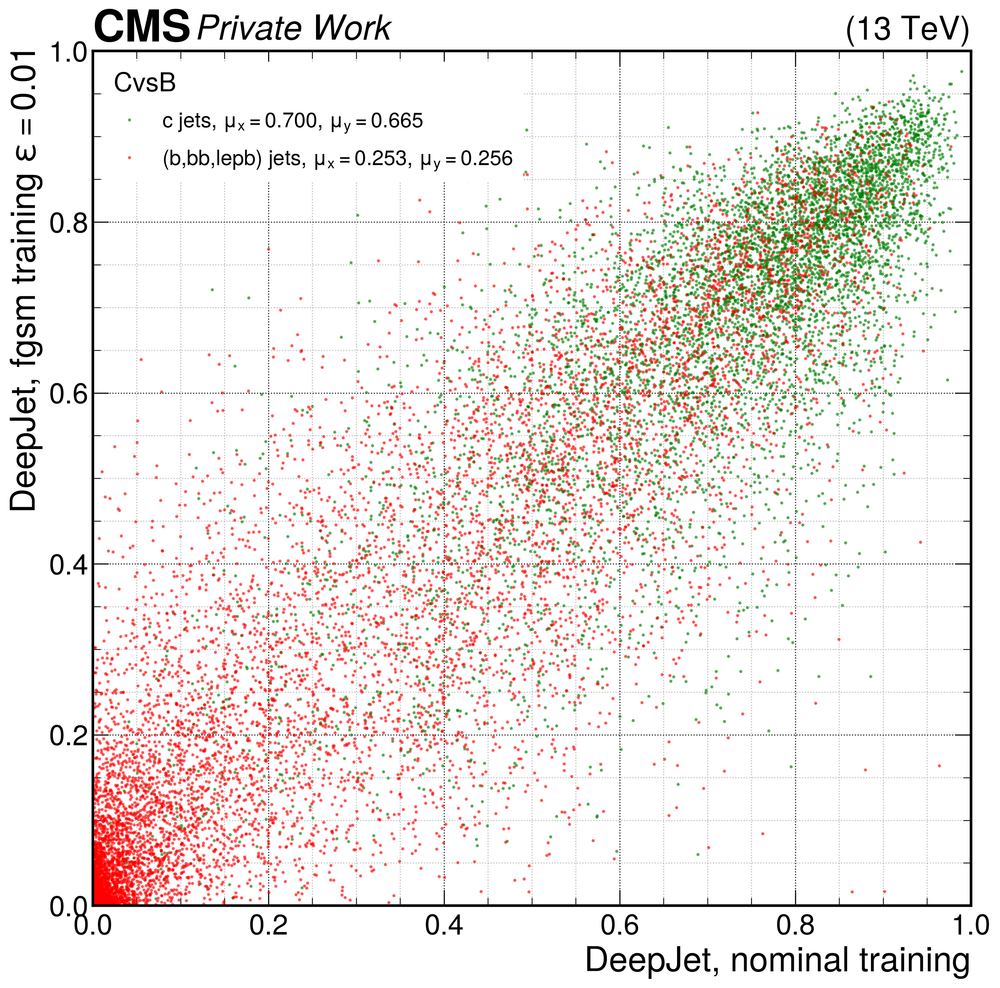

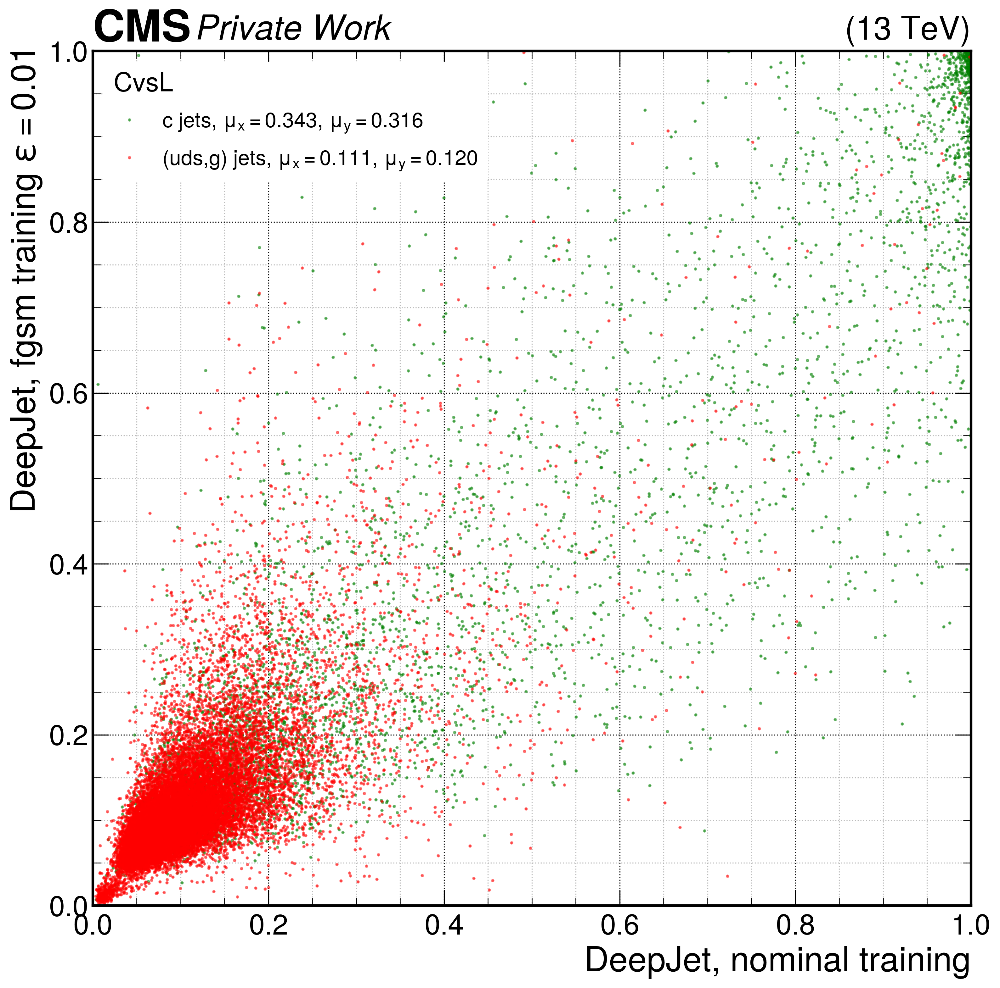

In [39]:
### plot correlation: discrimanators of different models (2D histogram)
models = ['nominal','fgsm-0_01']
quantities = ['BvsL', 'CvsB', 'CvsL']
flavours = [['B','L'], ['C','B'], ['C','L']]
colors = ['green','red']
            
for i,quantity in enumerate(quantities):
    quantity_array1 = model_outputs[models[0]][quantity]
    quantity_array2 = model_outputs[models[1]][quantity]
    fig,ax = plt.subplots(figsize=[12,12], dpi=300)
    ax.set_ylim(bottom=0, top=1)
    ax.set_xlim(left=0, right=1)
    ax.set_ylabel(model_labels[models[1]])
    ax.set_xlabel(model_labels[models[0]])
    ax.grid(which='minor', alpha=0.85)
    ax.grid(which='major', alpha=0.95, color='black')
    # plot histograms
    for j in range(2):
        flavour = flavours[i][j]
        flavour_array = flavour_arrays[flavour]
        x_array = quantity_array1[flavour_array==1]
        y_array = quantity_array2[flavour_array==1]
        label = '{}, $\mu_x =${:.3f}, $\mu_y =${:.3f}'.format(flavour_labels[flavour],np.mean(x_array),np.mean(y_array))
        color = colors[j]
        ax.plot(x_array, y_array, label=label, color=color, linestyle='None', marker='.', markersize=3, alpha=0.5)
    legloc = 'upper left'
    leg=ax.legend(title=quantity_labels[quantity], fontsize=16, title_fontsize=20, labelspacing=0.7, loc=legloc, frameon=True, framealpha=1, facecolor='white')
    if 'right' in legloc:
        aligned = 'right'
    else:
        aligned = 'left'
    leg._legend_box.align = aligned
    leg.get_frame().set_linewidth(0.0)
    hep.cms.label(llabel='Private Work', rlabel='(13 TeV)')
    fig.savefig('{}/outputs/correlation-{}.pdf'.format(saveDir,quantity))

In [45]:
### investigate zero-gradient jets
models = ['nominal','fgsm-0_01']

for model in models:
    pt = get_array('jet_pt', model=model, attack='nominal')
    adv_pt = get_array('jet_pt', model=model, attack='fgsm-0_01')
    zero_gradient_indices = np.where(pt==adv_pt)[0]
    print(model)
    print(len(zero_gradient_indices),' zero-gradient jets found')

nominal
0  zero-gradient jets found
fgsm-0_01
0  zero-gradient jets found
